# Time Domain Science Cases in the Galactic Plane

The purpose of this notebook is to evaluate the science cases that require time domain observations.  Here I distinguish these cases from those requesting proper motion measurements, since they tend to be distinct in their observational requirements.  For the purposes of this analysis, time domain science is identifed as those cases which requested more than 3 visits per field pointing over the lifetime of the survey.  

In [1]:
from os import path, getcwd
from sys import path as pythonpath
pythonpath.append(path.join(getcwd(), '..'))
import config_utils
import survey_footprints
import regions
import healpy as hp
from mw_plot import MWSkyMap, MWSkyMapBokeh
from astropy_healpix import HEALPix
from astropy import units as u
from astropy.coordinates import Galactic, TETE, SkyCoord
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import json
from os import path
%matplotlib inline


# Configure path to local repository
root_dir = '/Users/rstreet/software/rgps'

# HEALpixel grid resolution
NSIDE = 64
PIXAREA = hp.nside2pixarea(NSIDE, degrees=True)

First we load the simulation parameters for reference.

In [2]:
sim_config = config_utils.read_config(path.join(getcwd(), '..', 'config', 'sim_config.json'))

The requirements of all science cases proposed as White Papers and Science Pitches are described in the configuration file for this package:

In [3]:
science_cases = config_utils.read_config(path.join(root_dir, 'config', 'rgps_science_cases.json'))

Science cases requesting time domain observations are identifed in the configurations with a Boolean 'time_domain' key.  
So we can extract the information for just those cases for further analysis. 

In [4]:
time_domain_science = {author: info for author, info in science_cases.items() if info['time_domain']}
authors_list = [x for x in time_domain_science.keys()]
authors_list.sort()
print('Number of time domain science cases = ' + str(len(time_domain_science)))
print('\n')
print('Time domain authors and visit intervals [hrs] requested per region and filter:')
for author, params in time_domain_science.items():
    print(author + ': ')
    for optic in sim_config['OPTICAL_COMPONENTS']: 
        if optic in params.keys():
            for r in params[optic]:
                if 'l' in r.keys(): 
                    footprint = 'l: ' + repr(r['l']) + ', b:' + repr(r['b'])
                elif 'pointing' in r.keys():
                    footprint = 'pointing: ' + repr(r['pointing'])
                elif 'survey_footprint' in r.keys(): 
                    footprint = 'survey footprint: ' + r['survey_footprint'] 
                elif 'catalog' in r.keys():
                    footprint = 'catalog: ' + r['catalog']
                    
                print('  ' + optic + ' region=' + r['name'] + ' visit intervals=' + repr(r['visit_interval']) + ' footprint=' + footprint)

Number of time domain science cases = 15


Time domain authors and visit intervals [hrs] requested per region and filter:
Paladini2: 
  F213 region=Paladini_TDA visit intervals=[4.0, 6.0, 8.0, 10.0, 12.0, 14.0, 16.0] footprint=l: [25.0, 32.0], b:[2.0, 6.0]
Benecchi: 
  F146 region=Benecchi1 visit intervals=[2920.0] footprint=pointing: [17.43229895, -14.63082839, 0.52]
Kupfer: 
  F062 region=High_density1 visit intervals=[0.01] footprint=survey footprint: stellar_density
  F087 region=High_density1 visit intervals=[0.01] footprint=survey footprint: stellar_density
Lian: 
DAmmando: 
  F184 region=DAmmando_catalog visit intervals=[3.0] footprint=catalog: table-4LAC-DR3-l.fits
Freeman: 
  F158 region=RRLyrae1 visit intervals=[12.2] footprint=l: [-1, 1.0], b:[-3.0, 3.0]
  F158 region=RRLyrae2 visit intervals=[12.2] footprint=l: [89.0, 91.0], b:[-3.0, 3.0]
  F158 region=RRLyrae3 visit intervals=[12.2] footprint=l: [179.0, 181.0], b:[-3.0, 3.0]
  F158 region=RRLyrae4 visit intervals=[12.2] fo

## Sky Regions for Time Domain Surveys

It's informative to examine what regions of sky have been requested for time-domain surveys. To make this easier the regions for each science case have been pre-calculated, so we can load them all here, then select out those for time domain science.

In [5]:
science_regions = regions.load_regions_from_file(sim_config,
                                                         path.join(root_dir, 'config', 'rgps_science_regions.json'))

In [6]:
# Collect the regions for time domain science cases.  Note not all of them may be present; this 
# happens if a science case is marked not ready for use.  This is done if insufficient information has been provided by 
# an author.
time_domain_regions = {} 
for author in authors_list:
    if author in science_regions.keys():
        time_domain_regions[author] = science_regions[author]

Based on this collection of regions per optic, we can produce a combined map.

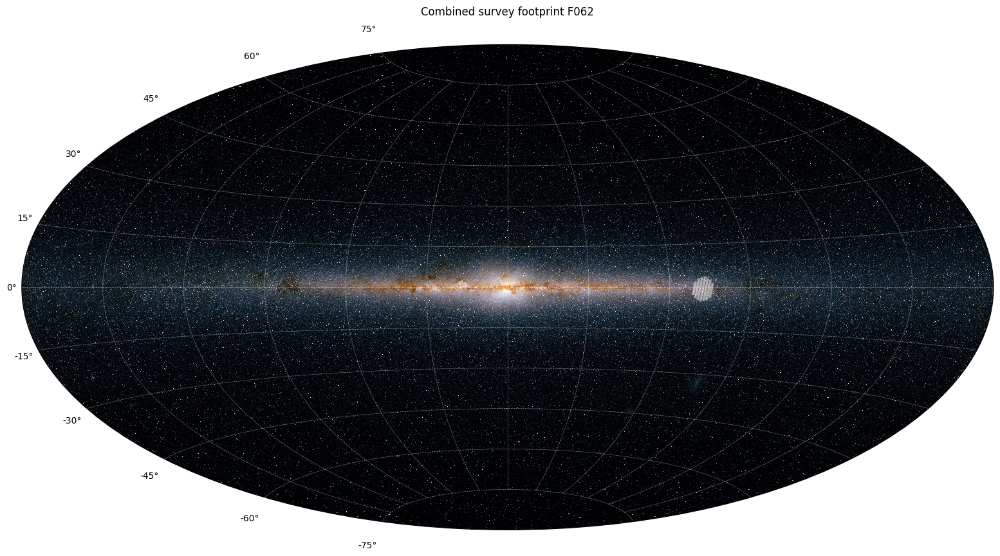

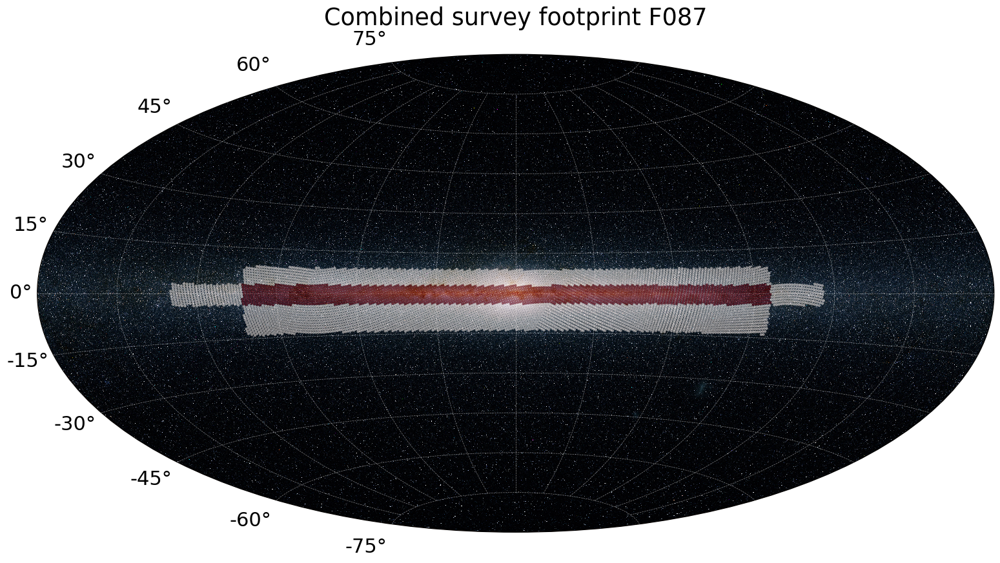

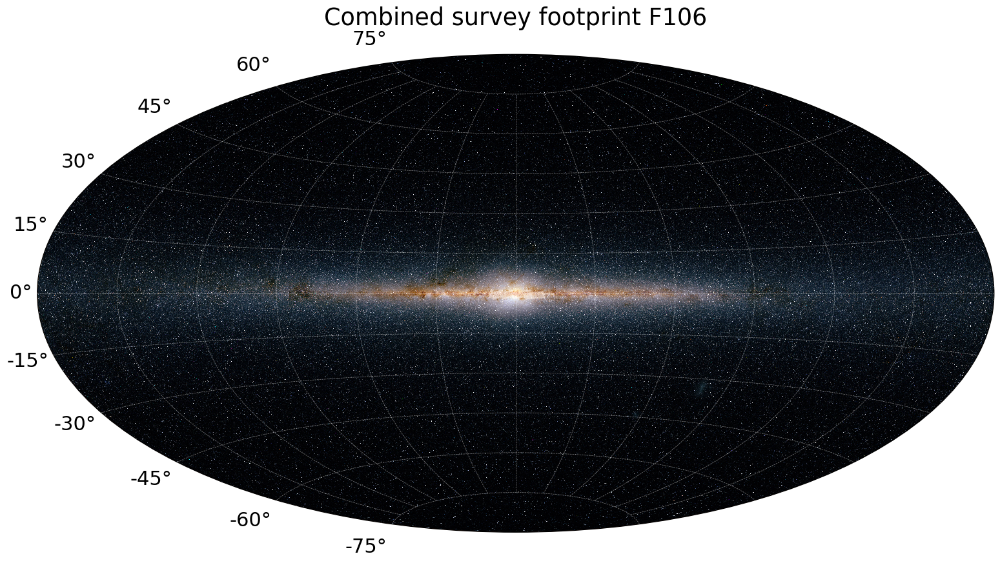

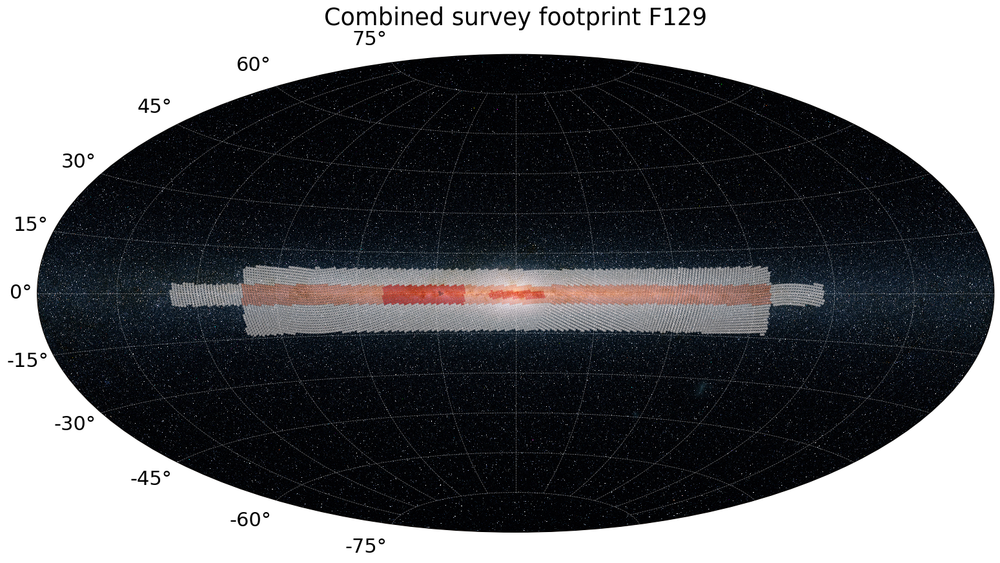

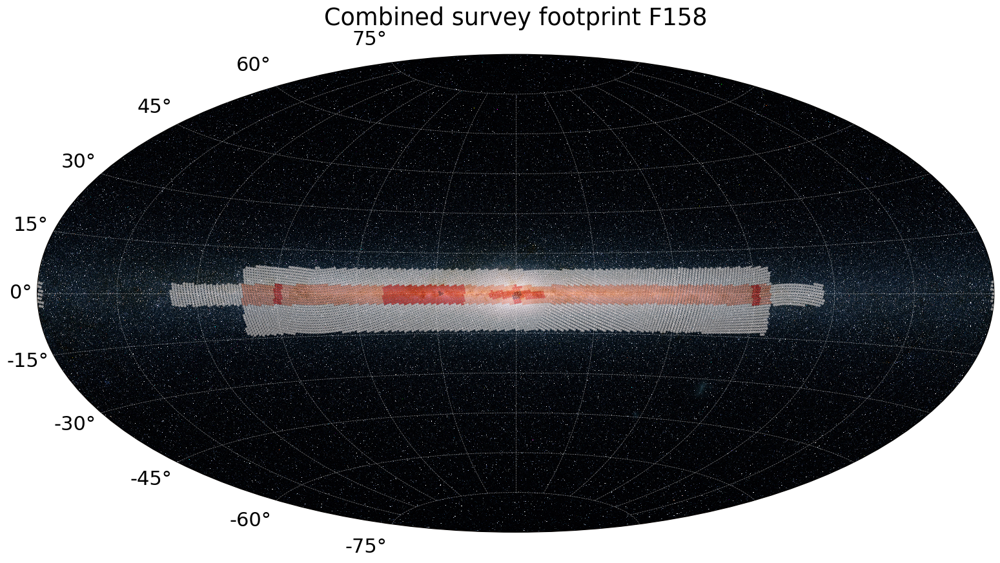

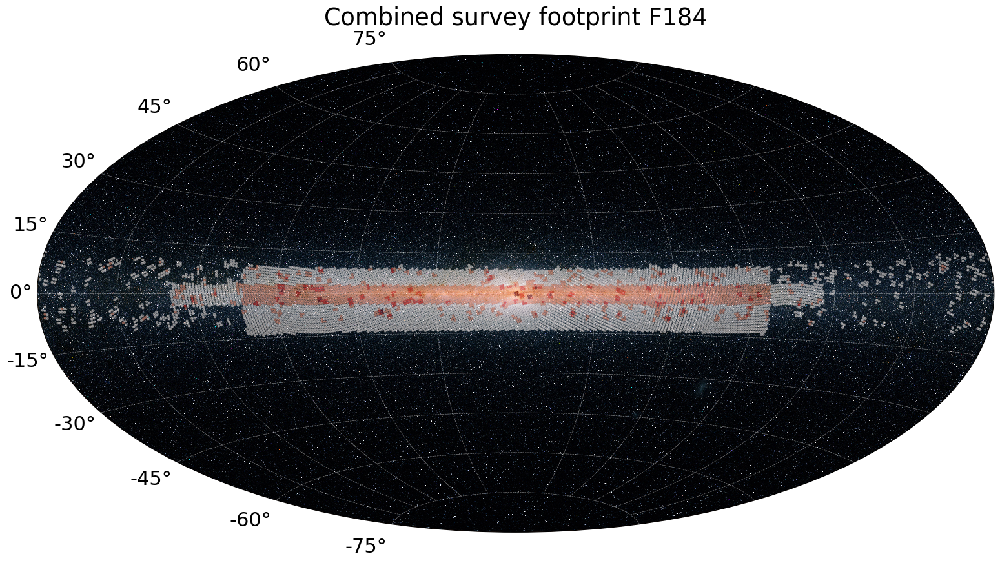

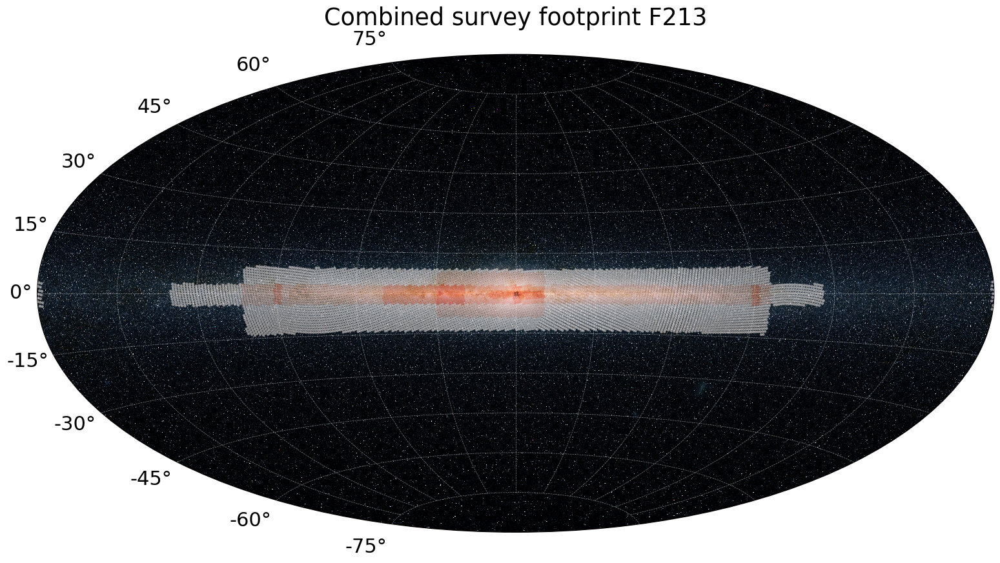

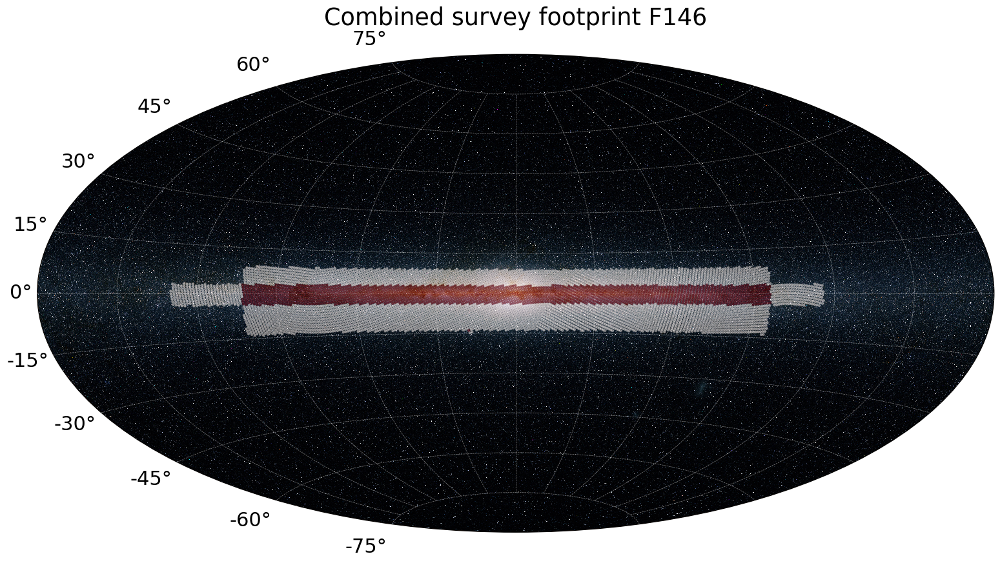

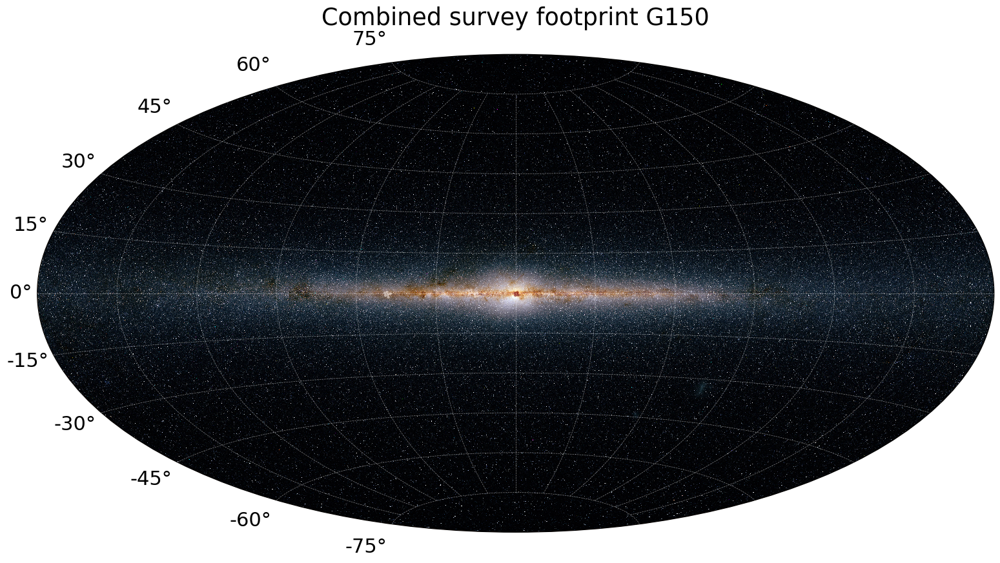

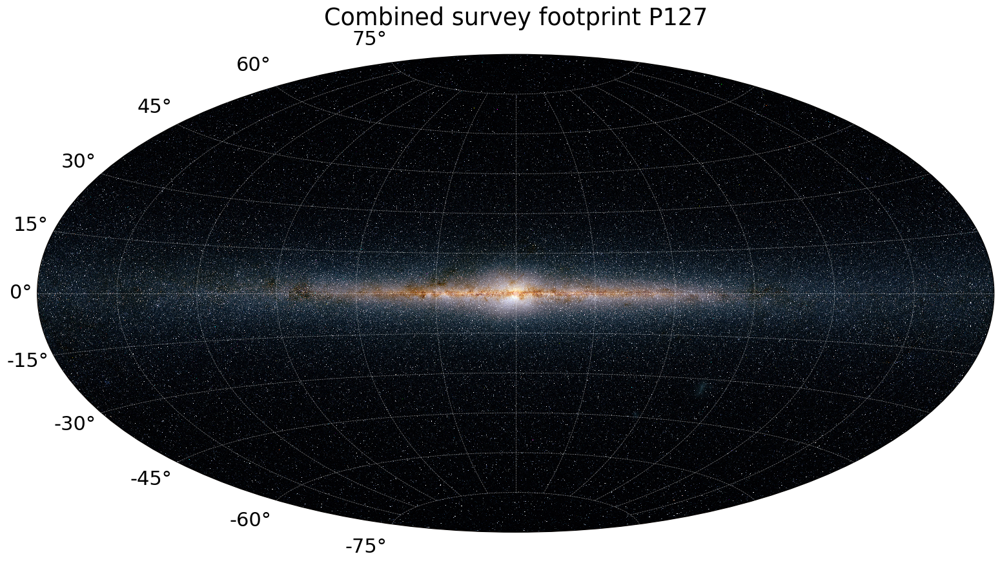

In [7]:
# Dictionary of the combined survey regions per optical component
combined_regions = {}

for optic in sim_config['OPTICAL_COMPONENTS']: 

    # Compile a list of regions for this optic over all science cases 
    region_list = []
    for author, params in time_domain_regions.items():
        if optic in params.keys():
            
            region_list += params[optic]
            
    if len(region_list) > 0:
        r_merge = regions.combine_regions(region_list)
        r_merge.optic = optic
        r_merge.label = 'Combined survey footprint'

        mw1 = MWSkyMap(projection='aitoff', grayscale=False, grid='galactic', background='infrared', figsize=(16, 10))
        mw1.title = r_merge.label + ' ' + r_merge.optic
        s = r_merge.pixels_to_skycoords()
        mw1.scatter(s.ra.deg * u.deg, s.dec.deg * u.deg, c=r_merge.region_map[r_merge.pixels], cmap='Reds', s=5, alpha=0.4)
        plt.rcParams.update({'font.size': 22})

        plt.tight_layout()
        plt.savefig(path.join(root_dir, 'time_domain_science', 'survey_map_'+r_merge.optic+'.png'))
                    
        combined_regions[optic] = r_merge

As the heatmaps above illustrate, the requested sky regions overlap in many cases, indicating that multiple science goals can be served by observations of those regions in that filter.  Since there is an obvious tension between the total area surveyed and the achievable cadence, it is helpful to explore the total area as a function of passband and the number of science cases.

## Optical Components Requested and Survey Area

We can also explore what filters have been requested specifically for time-domain surveys, and what total area of sky would be needed in each case.



In [8]:
survey_areas = np.zeros((len(sim_config['OPTICAL_COMPONENTS']), len(time_domain_science)+1))

for i, optic in enumerate(sim_config['OPTICAL_COMPONENTS']):
    r_merge = combined_regions[optic]
    print(optic)
    for n in range(1,len(time_domain_science)+1,1):
        
        # Calculate the number of pixels in the combined region map for this filter with values of n (science cases), 
        # and the corresponding total area
        npix = len(np.where(r_merge.region_map == n)[0])
        area = npix * PIXAREA
        survey_areas[i,n] = area
        print('Area required for ' + str(n) + ' science case(s) = ' + str(round(area,1))+'sq.deg.')

F062
Area required for 1 science case(s) = 57.9sq.deg.
Area required for 2 science case(s) = 0.0sq.deg.
Area required for 3 science case(s) = 0.0sq.deg.
Area required for 4 science case(s) = 0.0sq.deg.
Area required for 5 science case(s) = 0.0sq.deg.
Area required for 6 science case(s) = 0.0sq.deg.
Area required for 7 science case(s) = 0.0sq.deg.
Area required for 8 science case(s) = 0.0sq.deg.
Area required for 9 science case(s) = 0.0sq.deg.
Area required for 10 science case(s) = 0.0sq.deg.
Area required for 11 science case(s) = 0.0sq.deg.
Area required for 12 science case(s) = 0.0sq.deg.
Area required for 13 science case(s) = 0.0sq.deg.
Area required for 14 science case(s) = 0.0sq.deg.
Area required for 15 science case(s) = 0.0sq.deg.
F087
Area required for 1 science case(s) = 3473.0sq.deg.
Area required for 2 science case(s) = 1374.8sq.deg.
Area required for 3 science case(s) = 0.0sq.deg.
Area required for 4 science case(s) = 0.0sq.deg.
Area required for 5 science case(s) = 0.0sq.de

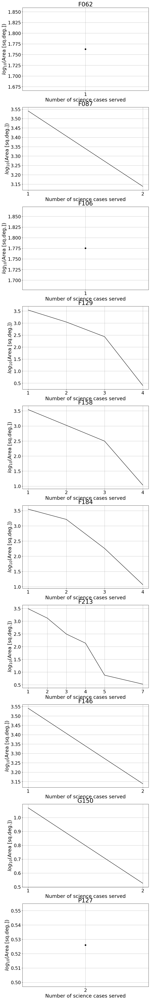

In [9]:
fig, axs = plt.subplots(len(sim_config['OPTICAL_COMPONENTS']), 1, figsize=(10,40))
plt.subplots_adjust(top=1.0, bottom=-0.5)

xticks = np.array([x for x in range(0, len(time_domain_science), 1)])
xticklabels = np.array([str(int(x)) for x in xticks])

for i in range(0,len(sim_config['OPTICAL_COMPONENTS']),1):
    kdx = np.where(survey_areas[i,:] > 0.0)[0]
    if len(kdx) > 1:
        axs[i].plot(xticks[kdx], np.log10(survey_areas[i,kdx]), 'k-')
    else:
        axs[i].plot(xticks[kdx], np.log10(survey_areas[i,kdx]), 'ko')
    axs[i].set_ylabel('$log_{10}$(Area [sq.deg.])')
    axs[i].set_xlabel('Number of science cases served')
    axs[i].tick_params(labelsize=20)
    axs[i].set_xticks(xticks[kdx])
    axs[i].set_xticklabels(xticklabels[kdx])
    axs[i].grid()
    axs[i].set_title(sim_config['OPTICAL_COMPONENTS'][i])

We can turn this around to identify key regions of interest to multiple science cases to be used as the basis of time domain fields as part of the Galactic Plane Survey. 

F062: No overlapping science case regions
[ 3598  3769  3770 ... 47109 47110 47111] [2. 2. 2. ... 2. 2. 2.]
F087: N overlap science cases=2 N HEALpixels=1638 area=1374.76sq.deg.
F106: No overlapping science case regions
[26183 26440 26695] [4. 4. 4.]
F129: N overlap science cases=4 N HEALpixels=3 area=2.52sq.deg.
[26183 26440 26695 36413 36414 36669 36670 36671 36924 36925 36926 37181
 37182] [4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4.]
F158: N overlap science cases=4 N HEALpixels=13 area=10.91sq.deg.
[ 6583 10841 10842 19283 19539 36413 36669 36670 36925 38204 38456 38459
 38460 40503] [4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4. 4.]
F184: N overlap science cases=4 N HEALpixels=14 area=11.75sq.deg.
[36413 36669 36670 36925] [7. 7. 7. 7.]
F213: N overlap science cases=7 N HEALpixels=4 area=3.36sq.deg.
[ 3598  3769  3770 ... 47109 47110 47111] [2. 2. 2. ... 2. 2. 2.]
F146: N overlap science cases=2 N HEALpixels=1639 area=1375.6sq.deg.
[36413 36669 36670 36925] [2. 2. 2. 2.]
G150: N overlap scien

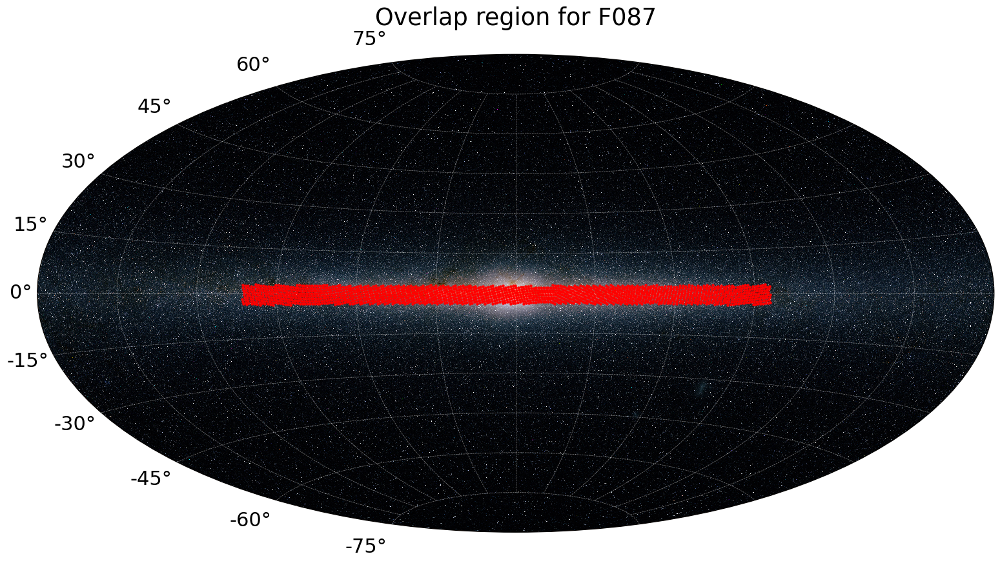

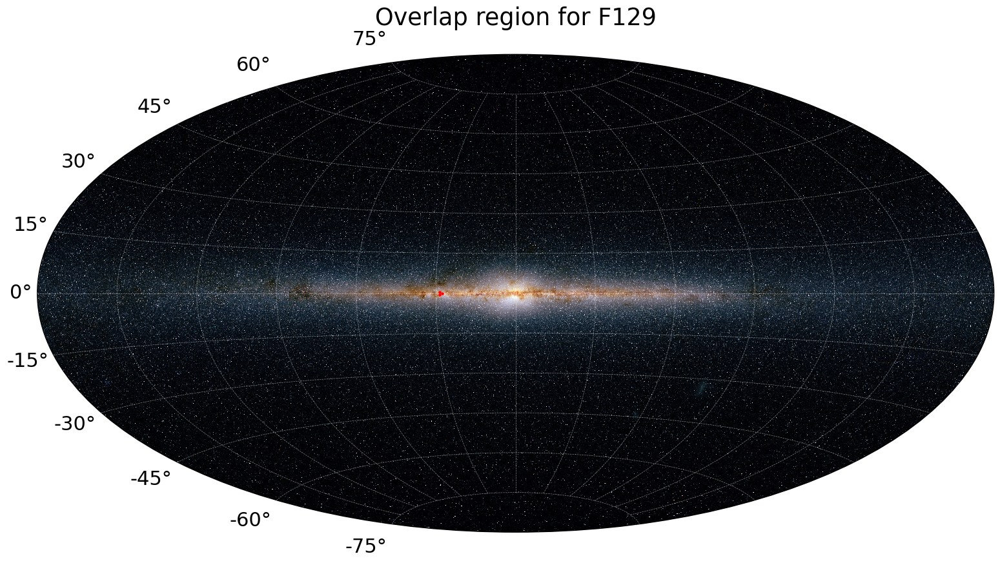

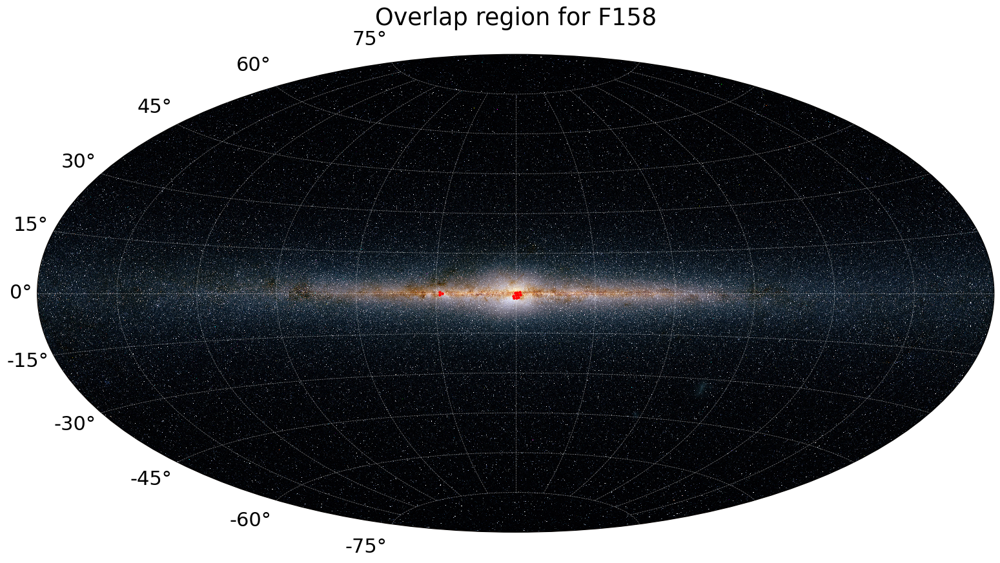

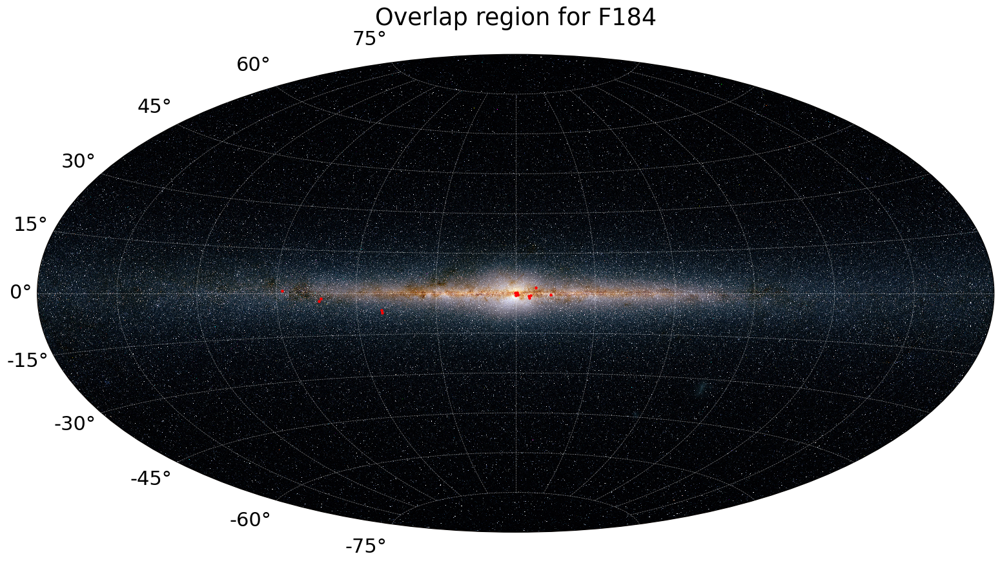

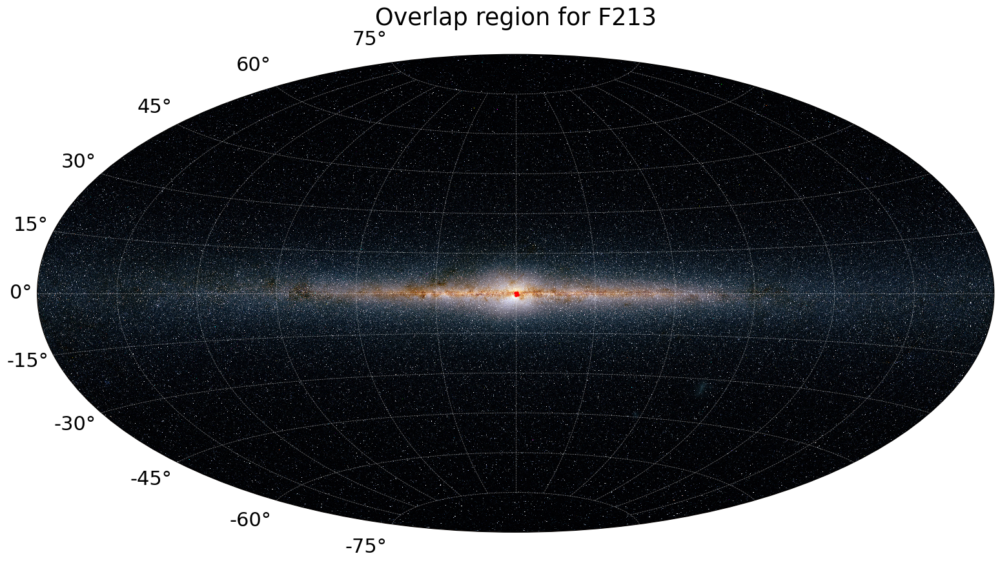

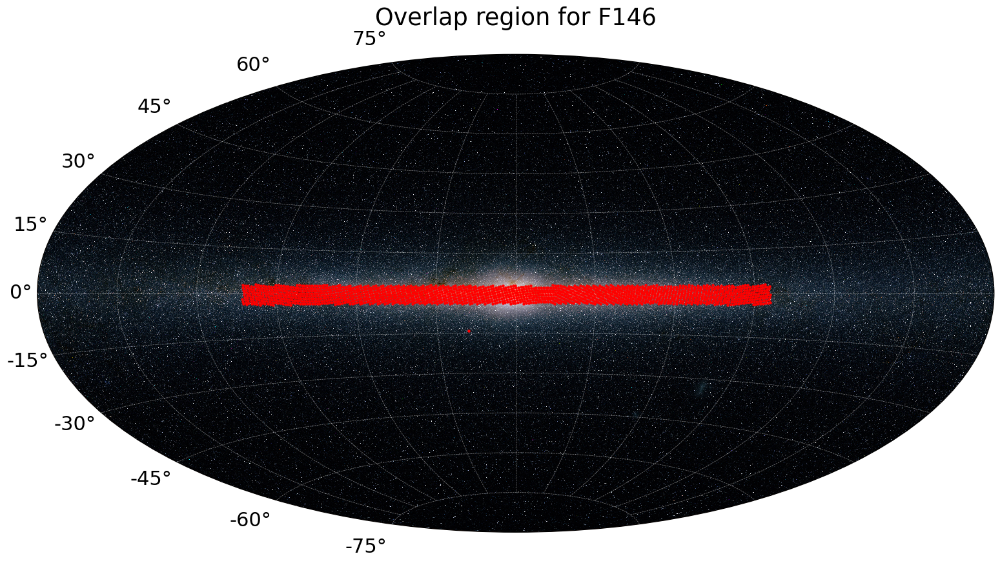

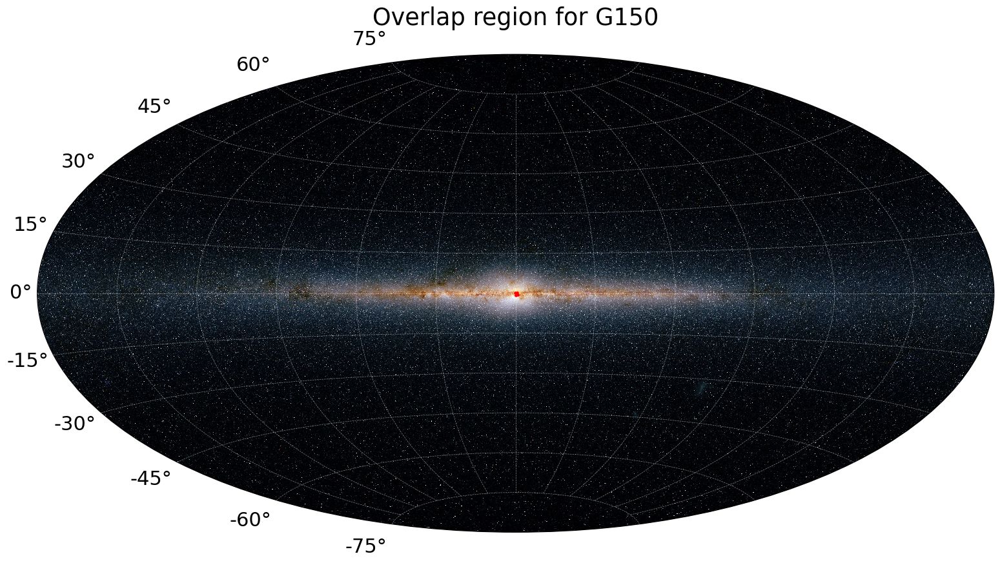

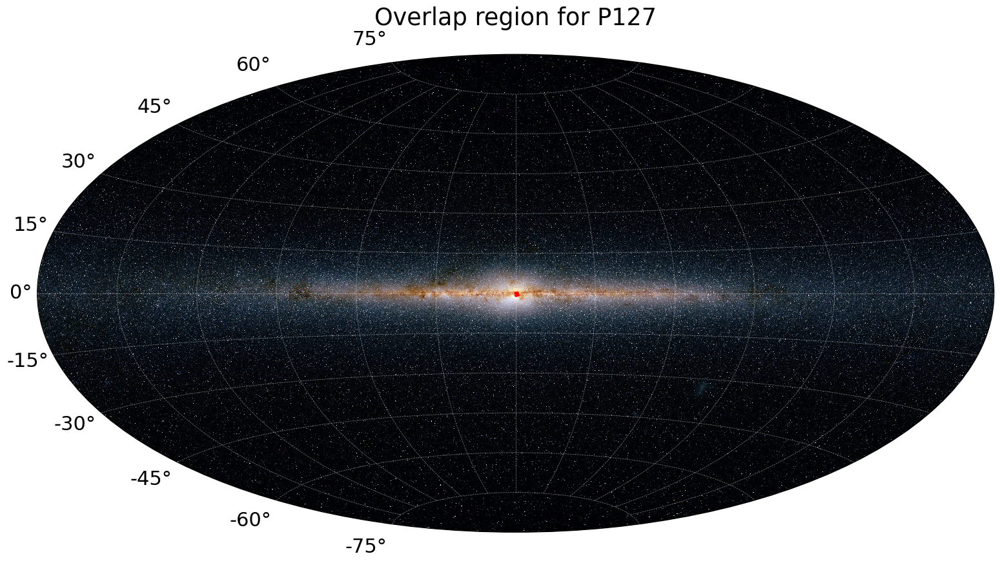

In [23]:
candidate_regions = {}

for i in range(0,len(sim_config['OPTICAL_COMPONENTS']),1):
    optic = sim_config['OPTICAL_COMPONENTS'][i]
    
    # Use the merged region map to identify where the regions of overlap are:
    r_merge = combined_regions[optic]
    
    if r_merge.region_map.max() > 1:
        pixels = np.where(r_merge.region_map == r_merge.region_map.max())[0]
        candidate_regions[optic] = pixels
        
        area = len(pixels) * PIXAREA
        print(optic + ': N overlap science cases=' + str(int(r_merge.region_map.max())) 
              + ' N HEALpixels=' + str(len(pixels)) + ' area=' + str(round(area,2)) + 'sq.deg.')
    
        # Plot these regions 
        mw1 = MWSkyMap(projection='aitoff', grayscale=False, grid='galactic', background='infrared', figsize=(16, 10))
        mw1.title = 'Overlap region for ' + optic
        proj = HEALPix(nside=64, order='ring', frame='icrs')
        
        s = proj.healpix_to_skycoord(pixels)
        mw1.scatter(s.ra.deg * u.deg, s.dec.deg * u.deg, c='r', s=5, alpha=1.0)
        plt.rcParams.update({'font.size': 22})
    
        plt.tight_layout()
        plt.savefig(path.join(root_dir, 'time_domain_science', 'tfa_overlap_region_map_'+optic+'.png'))

    else:
        print(optic + ': No overlapping science case regions')

We can also chart the number of science cases that requested each filter directly.

In [ ]:
# Count the number of science cases that request each optical component
case_count = np.zeros(len(sim_config['OPTICAL_COMPONENTS'])+1)
cases = {n: [] for n in range(1,len(sim_config['OPTICAL_COMPONENTS'])+1,1)}

for author, info in time_domain_science.items():
    nf = 0
    for key in sim_config['OPTICAL_COMPONENTS']:
        if key in info.keys():
            nf += 1
    if nf > 0:
        case_count[nf] += 1
        cases[nf].append(author)

print('Science cases requesting N filters:')
for nf in range(1,9,1):
    if len(cases[nf]) > 0:
        print(str(nf) + ' filter(s): ' + ' '.join(cases[nf]))

fig = plt.figure(1,(7,7))

plt.bar(np.arange(1,len(sim_config['OPTICAL_COMPONENTS'])+1,1), case_count[1:])

plt.xlabel('Number of filters requested')
plt.ylabel('Number of science cases')

plt.title('Number of science cases requesting N filter bandpasses')

In [ ]:
# Count for community contributed science cases
nvotes = [0]*len(sim_config['OPTICAL_COMPONENTS'])

for author, info in time_domain_science.items():
    for i, key in enumerate(sim_config['OPTICAL_COMPONENTS']):
        if key in info.keys():
            nvotes[i] += 1

labels = [sim_config['OPTICAL_COMPONENTS'][i] + ': ' + str(nvotes[i]) for i in range(0,len(sim_config['OPTICAL_COMPONENTS']),1)]

fig, axs = plt.subplots(1,1, figsize=(3,3))

colors = plt.get_cmap('Blues')(np.linspace(0.2, 0.7, len(nvotes)))

axs.pie(nvotes, colors=colors, radius=3, center=(4, 4),
       wedgeprops={"linewidth": 1, "edgecolor": "white"}, frame=False,
      labels=labels)
axs.set_title('Number of science cases requesting each filter', y=2.0)


## Intervals requested for time domain observations

Most science pitches did not define specific requirements for cadence (or interval between observations of the same field).  In many cases, the optimization between the total area covered and the achievable cadence was left to the committee/mission.  
Reviewing the information given for each time domain science case:

In [ ]:
for author, info in time_domain_science.items():
    if 'cadence' in info.keys():
        if 'minimum_area' in info.keys():
            print(author + ' - cadence requested: ' + info['cadence'] + ' for a minimum area of ' + str(info['minimum_area']) + 'deg')
        else:
            print(author + ' - cadence requested: ' + info['cadence'])

We can also histogram the visit intervals requested.

In [ ]:
intervals = []

for author, params in time_domain_science.items():
    for optic in sim_config['OPTICAL_COMPONENTS']: 
        if optic in params.keys():
            for r in params[optic]:
                if r['visit_interval'][0] is not None:
                    intervals += r['visit_interval']

# Convert visit intervals to days
intervals = np.array(intervals)/24.0

In [ ]:
fig = plt.figure(1,(7,7))

plt.hist(intervals, bins=np.arange(0,intervals.max()*1.1,10.0))

plt.xlabel('Interval between observations [days]')
plt.ylabel('Number of requests')